# Pattern Discovery and Building Predictive Models
### PROJECT 2 - CITS 3401
#### Authors:


# <u>Introduction</u>

For this project, we would like to use the mobile price classification dataset as the source of data. The target of this project is to predict whether the price of a mobile phone is high or not.

<br />

### Tasks and Scope

#### 1) Data cleaning and analysis

  - Read through the table and the table column descriptions. Understand the meaning of each column in the table.
  - Distinguish the type of each attribute (e.g., nominal/categorical, numerical). You may need to discretise some attributes, when completing Task 2, 3 or 4.
  - Determine whether an attribute is relevant to your target variable. You may remove some attributes if they are not helpful for Task 2, 3, or 4. You might create separate data files for Task 2, 3 and 4.
  - Identify inconsistent data and take actions using the knowledge you have learnt in this unit.

#### 2) Association rule mining
  - Select a subset of the attributes (or all the attributes) to mine interesting patterns. To rank the degree of interesting of the rules extracted, use support, confidence and lift.
  - Explain the top k rules (according to lift or confidence) that have the "price_category” on the right-hand-side, where k >= 1.
  - Explain the meaning of the k rules in plain English.
  - Given the rules, what recommendation will you give to a company willing to design a high price mobile phone (e.g., should the mobile phone equipped with bluetooth)?

#### 3) Classification
  - Use the "price_category" as the target variable and train two classifiers based on different machine learning algorithms (e.g. classifier 1 based on a decision tree; classifier 2 based on SVMs).
  - Evaluate the classifiers based on some evaluation metrics (e.g., accuracy). You may use 10-fold cross-validation for the evaluation.

#### 4) Clustering
  - Run a clustering algorithm of your choice and explain how the results can be interpreted with respect to the target variable.

#### 5) Data reduction
  - Perform numerosity reduction and perform attribute reduction.
  - Train the two classifiers in Task 3 on the reduced data.
  - Answer the question: "Does data reduction improve the quality of the classifiers"?

#### 6) Attribute selection
  - Select the top-10 most important attributes manually based on your understanding of the problem; select the top-10 most important attributes based on Information Gain.
  - Which attribute selection method is better and why?

<br />

#### **Marking Scheme**
```
[5 marks]   Explain the data processing operations (e.g., remove some attributes and action on inconsistent data) that you have done.
[5 marks]   Explain and interpret the top k association rules mined; based on the association rules, provide a recommendation for a company willing 
            to design a high price mobile phone.
[5 marks]   Explain how you train the classifiers and your evaluation results.
[5 marks]   Clustering and interpretation of the clustering result (with respect to the target variable)
[5 marks]   Explain the data reduction you have performed; compare the classifiers trained on reduced data with the classifiers trained on the original data.
[5 marks]   Your answer to Task 6.
```

### Tools, Libraries and Packages

Python - Using throughout the project for data cleaning, data processing, and modelling.
Weka - Used a discrepency check (to ensure we receive the same values)

#### Imports

In [1]:
pip install pandas-profiling[notebook]  mlxtend clusteval --user

Note: you may need to restart the kernel to use updated packages.


In [2]:
# Data analysis, manipulation, and profiling
import pandas as pd
import numpy as np
from pandas_profiling import ProfileReport

# Visualization
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("darkgrid", {"axes.facecolor": ".9"})

# Association Rule Mining
from mlxtend.frequent_patterns import apriori, association_rules

# Training Setups
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline

# Preprocessings and Attribute Selections
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
# selection of best attributes from by default using f-score https://scikit-learn.org/stable/modules/generated/sklearn.feature_selection.f_classif.html
from sklearn.feature_selection import SelectKBest, mutual_info_classif, f_classif

# Classifiers
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.svm import SVC # Support Vector Machine Classifier

RANDOM_STATE = 1 # Used as a seed value
CROSS_VALIDATION_PARTITION = 10

# Optimisation
from sklearn.model_selection import GridSearchCV # tuning the model
from sklearn.model_selection import cross_val_score, cross_validate

# Clustering
from clusteval import clusteval
from sklearn.preprocessing import MinMaxScaler
from sklearn.cluster import KMeans, AgglomerativeClustering
from scipy.cluster import hierarchy
from scipy.cluster.hierarchy import dendrogram

<br >

# <u>Data Cleaning and Profiling</u>

There are many different ways to perform data cleaning and profiling. For this process (in Project 2) we will be using an IPython Notebook, for the following reasons:

- The anaylsts are proficient in Python;
- The report can be integrated with code for specific sections of the analysis;
- The processes / procedures are highly repeatable and easily automated using scripts;
- Data exploration and anomaly detection can easily be performed through a variety of visualizations (charts, graphs, tables, etc);

The packages that will be used are built-in the Anaconda package, except for `pandas_profiling` (from https://github.com/pandas-profiling/pandas-profiling, which we used for doing detailed exploratory analysis of data), and `mlxtend` (from https://github.com/rasbt/mlxtend , which we used in our association rule mining).
Data profiling is important to measure the quality of data, which in turn assists greately in the determination of data anomalies/inconsistencies, and as such, necessary data transformations.
The data profiling reports will be generated with Pandas Profiling. Portions of these reports will be referenced in our project discussion, with the resource/s (data profiling reports) attached as an Appendix.


In [3]:
raw_data = pd.read_csv("./data/raw/mobile_price.csv")
raw_metadata = pd.read_excel("./data/raw/ColumnDescription.xlsx", index_col="Column")

raw_data

,id,battery_power,blue,clock_speed,dual_sim,fc,four_g,int_memory,m_dep,mobile_wt,...,px_height,px_width,ram,sc_h,sc_w,talk_time,three_g,touch_screen,wifi,price_category
0,0,842,no,2.2,no,1,0,7,0.6,188,...,20,756,2549,9,7,19,no,0,yes,0
1,1,1021,yes,0.5,YES,0,1,53,0.7,136,...,905,1988,2631,17,3,7,yes,1,no,0
2,2,563,yes,0.5,Yes,2,1,41,0.9,145,...,1263,1716,2603,11,2,9,yes,1,no,0
3,3,615,has,2.5,no,0,0,10,0.8,131,...,1216,1786,2769,16,8,11,Yes,0,no,0
4,4,1821,yes,1.2,NO,13,1,44,0.6,141,...,1208,1212,1411,8,2,15,Yes,1,no,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,1995,794,yes,0.5,yes,0,1,2,0.8,106,...,1222,1890,668,13,4,19,yes,1,No,0
1996,1996,1965,yes,2.6,yes,0,0,39,0.2,187,...,915,1965,2032,11,10,16,has,1,yes,0
1997,1997,1911,no,0.9,yes,1,1,36,0.7,108,...,868,1632,3057,9,1,5,yes,1,no,1
1998,1998,1512,no,0.9,not,4,1,46,0.1,145,...,336,670,869,18,10,19,Yes,1,yes,0


In [4]:
raw_metadata.to_dict()["Explaination"]

{'id': 'ID',
 'battery_power': 'Total energy a battery can store in one time measured in mAh',
 'blue': 'Has bluetooth or not',
 'clock_speed': 'speed at which microprocessor executes instructions',
 'dual_sim': 'Has dual sim support or not',
 'fc': 'Front Camera mega pixels ',
 'four_g': 'Has 4G or not. 1 = yes , 0 = no',
 'int_memory': 'internal Memory in Gigabytes',
 'm_dep': 'Mobile Depth in cm',
 'mobile_wt': 'Weight of mobile phone',
 'n_cores': 'Number of cores of processor',
 'pc': 'Primary Camera mega pixels',
 'px_height': 'Pixel Resolution Height',
 'px_width': 'Pixel Resolution Width',
 'ram': 'Random Access Memory in Mega Bytes',
 'sc_h': 'Screen Height of mobile in cm',
 'sc_w': 'Screen Width of mobile in cm',
 'talk_time': 'longest time that a single battery charge will last when you are',
 'three_g': 'Has 3G or not',
 'touch_screen': 'Has touch screen or not, 1 = yes, 0 = no',
 'wifi': 'Has wifi or not',
 'price_category': 'This is the target variable with indicating if

### Profiling Report

With the imported metadata, and raw dataset, we can now populate and generate a `pandas_profiling` report. For reference, see `Raw Data Profiling Report`, in the apendix.


<br /> 

## Initial (raw import data) Interpretation, and Cleaning Strategy

Here, we will walk through the fields presented in the profile of the raw data, and make the appropriate alterations / assumptions / cleaning steps. In the event of changes, we will apply them to the `staging_data` dataframe, and `staging_metadata` dictionary.

In [5]:
# Clone the raw data & metadata 
staging_data = raw_data.copy()
staging_metadata = raw_metadata.copy()

# By default the new_name is the old_name
staging_metadata["new_name"] = staging_metadata.index

In [6]:
# helper functions
    
def string_to_bool(value):
    """
    Converts String representation of Boolean ("yes", "has")/("no","not") to True/False
    """
    if value.lower() in ["yes","has"]:
        return True
    elif value.lower() in ["no","not"]:
        return False
    return None


def int_to_bool(value):
    """
    Converts int representation of Boolean (1, 0) to True/False
    """
    return value == 1


def create_discretized_col(df, target_col, new_col_name=None, is_zero_its_own_category=True):
    """
    This function discretises the column
    """
    # Default value of new col
    if new_col_name is None:
        new_col_name = f"{target_col}_category"
        
    col_holder = df[target_col]
    df[new_col_name] = 0 # Initialise
    
    if is_zero_its_own_category:
        df.loc[col_holder>0, new_col_name] = pd.cut(col_holder[col_holder>0],bins=4,include_lowest=True)
    else:
        df.loc[:, new_col_name] = pd.cut(col_holder,bins=4,include_lowest=True)
    
    return df


_____
#### `ID`
The id field is unique, and it seems to be a good candidate for primary key.  Note, we will NOT be using ID for any analysis, as it is an irrelevant attribute.


_______
#### `battery_power`
The battery_power has 1094 distinct counts, approximately half the distinct counts of id.  This data is continuous, and as such, we shall discretise for the later association rule mining.

In [7]:
# Discretizing battery_power
staging_data = create_discretized_col(staging_data, "battery_power", is_zero_its_own_category = False)

________

#### `blue`
This ("has bluetooth") field is a categorical data type (*boolean*), expressed (poorly) in string-form with inconsistencies.  We observe 10 distinct values that all refer to either the phone has bluetooth (True) or not (False). The inconsistencies must be attributed to an appropriate boolean value, and as such, this field needs to be cleaned.

In [8]:
staging_data["has_bluetooth"] = staging_data["blue"].apply(string_to_bool)
staging_metadata.loc["blue","new_name"] = "has_bluetooth"  # Rename metadata

_____
#### `clock_speed`
The clock_speed attribute has 26 distinct values for which 413 of the records have value 0.5. Hence the distribution of values in the histogram is right skewed.  This data is continuous, and will also need to be discretised if we wish to use it in the association rule mining process.

In [9]:
# Discretizing clock_speed
staging_data = create_discretized_col(staging_data, "clock_speed", is_zero_its_own_category = False)

_____
#### `dual_sim`
The dual_sim attirbute is similar to `blue` attribute wherein it is a categorical datatype (*boolean*) with inconsistencies sppread to 10 string distinct values. Hence, the procedure of cleaning will be similar.

In [10]:
staging_data["has_dual_sim"] = staging_data["dual_sim"].apply(string_to_bool)
staging_metadata.loc["dual_sim","new_name"] = "has_dual_sim"  # Rename metadata

___
#### `fc`
The (*Front Camera*) `fc` attribute has 474 (23.7% of the dataset) zero values.  We will be interpreting the zero values as "this phone does not have a front camera" , (please see the ***Data Privacy Disclaimer*** below).  In addition, this continous data will be discretised, for later (association rule mining) purposes, with the zero values as a seperate category.

In [11]:
staging_data["front_cam_resolution"] = staging_data["fc"]
staging_metadata.loc["fc","new_name"] = "front_cam_resolution" # Rename metadata
staging_data = create_discretized_col(staging_data, "front_cam_resolution", is_zero_its_own_category = True) # Discretizing front_cam_resolution

___
#### `four_g`
The `four_g` attribute is a categorical (*boolean*) attribute indicated by "yes=1" and "no=0" of having 4G capability. For consistency, this will be converted from numeric (0 or 1) to boolean type.

In [12]:
staging_data["has_four_g"] = staging_data["four_g"].apply(int_to_bool)
staging_metadata.loc["four_g","new_name"] = "has_four_g" # Rename metadata

_______



#### `int_memory`
The `int_memory` (*Internal Memory*) attribute has 63 distinct values that vary as shown in the *profiling-report* histogram. There are no records of phones having `0 GB` as the storage which would be expected, as phones would require a minimum amount of memory to host their respective operating software/s.  This continuous data will be discretised for later use in the association rule mining.

In [13]:
staging_data = create_discretized_col(staging_data, "int_memory", is_zero_its_own_category = False) # Discretizing int_memory

____________

#### `m_dep`
The `m_dep` (*Mobile Depth*) attribute has 10 distinct values that vary as shown in the *profiling-report* histogram. The minimum values do not make much sense, however, please refer to the ***Data Privacy Disclaimer*** below.  In addition, this continuous data will be discretised for later (association rule mining) purposes.

In [14]:
staging_data["mobile_depth"] = staging_data["m_dep"]
staging_metadata.loc["m_dep","new_name"] = "mobile_depth"  # Rename metadata
staging_data = create_discretized_col(staging_data, "mobile_depth", is_zero_its_own_category = False) # Discretizing mobile_depth

______________
#### `mobile_wt`
The `mobile_wt` (*Mobile Weight*) attribute has 121 distinct values that varies as shown in the *profiling-report* histogram. The minimum is `80` and the maximum is `200`, measured in presumably grams. This continuous data will be discritised for later association rule mining purposes.

In [15]:
staging_data["mobile_weight"] = staging_data["mobile_wt"] 
staging_metadata.loc["mobile_wt","new_name"] = "mobile_weight" # Rename metadata
staging_data = create_discretized_col(staging_data, "mobile_weight", is_zero_its_own_category = False) # Discretizing mobile_weight

________
#### `n_cores`
The `n_cores` (*Number of Cores*) attribute looks almost uniform in the range `1-8`. This is categorical (numerical) data.

In [16]:
staging_data["number_of_cores"] = staging_data["n_cores"]
staging_metadata.loc["n_cores","new_name"] = "number_of_cores" # Rename metadata

________________
#### `pc`
The `pc` (*Primary Camera Resolution*) attribute has 21 distinct values with 101 (5.1% of the dataset) with zero values. We will be interpreting the zero values as "this phone does not have a primary camera", (please see the ***Data Privacy Disclaimer*** below).  In addition, this continous data will be discretised, for later (association rule mining) purposes, with the zero values as a seperate category.

In [17]:
staging_data["primary_cam_resolution"] = staging_data["pc"]
staging_metadata.loc["pc","new_name"] = "primary_cam_resolution"
staging_data = create_discretized_col(staging_data, "primary_cam_resolution", is_zero_its_own_category = True) # Discretizing primary_cam_resolution

_____
#### `px_height`
The `px_height` attribute has a right skewed normal distribution with a mean value of `645` pixels and `443.79` standard deviation in the range `0-1960`.  We will be interpreting the two zero values as *extremely small, but not zero* values, (please see the ***Data Privacy Disclaimer*** below). This notion also applies to the nonsensicle low values. In addition, this continous data will be discretised, for later (association rule mining) purposes.

In [18]:
# Discretizing px_height
staging_data = create_discretized_col(staging_data, "px_height", is_zero_its_own_category = False)

______
#### `px_width`
The `px_width` attribute has a varying distribution of values in the range 500 to 1998. This continous data will be discretised, for later (association rule mining) purposes.

In [19]:
# Discretizing px_width
staging_data = create_discretized_col(staging_data, "px_width", is_zero_its_own_category = False)

_____
#### `ram`
The `ram` attribute has a varying distribution of values in the range `256-3998`. This continous data will be discretised, for later (association rule mining) purposes.

In [20]:
# Discretizing ram
staging_data = create_discretized_col(staging_data, "ram", is_zero_its_own_category = False)

_____
#### `sc_h`
The `sc_h` (*Screen Height*) attributes has 15 distinct values with a range of `5-19`. This continous data will be discretised, for later (association rule mining) purposes.

In [21]:
staging_data["screen_height"] = staging_data["sc_h"]
staging_metadata.loc["sc_h","new_name"] = "screen_height" # Rename metadata
staging_data = create_discretized_col(staging_data, "screen_height", is_zero_its_own_category = False) # Discretizing screen_height

______________
#### `sc_w`
The `sc_w` (*Screen Width*) attribute has 19 distinct values with a range of `0-18` with 180 zero values. These zero values do not make *real world sense*, and so we will be interpreting the zero values as representatives of sensible, lower values (please see the ***Data Privacy Disclaimer*** below). This continous data will be discretised, for later (association rule mining) purposes.

In [22]:
staging_data["screen_width"] = staging_data["sc_w"]
staging_metadata.loc["sc_w","new_name"] = "screen_width" # Rename metadata
staging_data = create_discretized_col(staging_data, "screen_width", is_zero_its_own_category = False) # Discretizing screen_width

______
#### `talk_time`
The `talk_time` attribute has 19 distinct values with a range `2-20`. This continous data will be discretised, for later (association rule mining) purposes.

In [23]:
# Discretizing talk_time
staging_data = create_discretized_col(staging_data, "talk_time", is_zero_its_own_category = False)

_______
#### `three_g`
The `three_g` attribute is similar to the `blue` and `dual_sim` attribute wherein it is a categorical (*boolean*) datatype, with inconsistencies spread to 10 (string) distinct values. Hence, the cleaning procedure will be similar.

In [24]:
staging_data["has_three_g"] = staging_data["three_g"].apply(string_to_bool)
staging_metadata.loc["three_g","new_name"] = "has_three_g" # Rename metadata

_____
#### `touch_screen`
The `touch_screen` attribute is a categorical (*boolean*) attribute ,similar to the representation of `four_g`. Hence, the cleaning procedure is similar.

In [25]:
staging_data["has_touch_screen"] = staging_data["touch_screen"].apply(int_to_bool)
staging_metadata.loc["touch_screen","new_name"] = "has_touch_screen" # Rename metadata

_____
#### `wifi`
The `wifi` attirbute is similar to `blue`,`dual_sim` and `three_g` attribute wherein it is a boolean datatype with inconsistencies spread to 10 (string) distinct values. Hence, the procedure of cleaning will be similar.

In [26]:
staging_data["has_wifi"] = staging_data["wifi"].apply(string_to_bool)
staging_metadata.loc["wifi","new_name"] = "has_wifi" # Rename metadata

________
#### `price_category`
The `price_category` attribute is a categorical (*boolean*) attribute, similar to the representation of `four_g` and `touch_screen`. Hence, the cleaning procedure is similar.

In [27]:
staging_data["is_expensive"] = staging_data["price_category"].apply(int_to_bool)
staging_metadata.loc["price_category","new_name"] = "is_expensive" # Rename metadata

__________

### ***Data Privacy Disclaimer***

The data provided (`mobile_prices.csv`) has had some of it's *real world* values altered, for privacy/legal reasons.  As such, decisions were made on how to best interpret unusual / nonsensicle `zero` values.


#### **Appropriate zero values** (`primary_camera_resolution`, `front_camera_resolution`)
Zero values for these attributes can be observed as the phone not having the attribute. This makes sense, as not all phones have a front camera, or primary camera.


#### Inappropriate zero values (`px_height`, `screen_width`)
Zero values for these attributes can be observed as **values altered for privacy reasons**, and should be interpreted as a representation of a low value (but **NOT** zero).


<br>

### Set `cleaned_data`

- Declare our `cleaned_data`, `discretised_data` and `cleaned_metadata`;
- Generate "clean" pandas-profiling report;
- Export these to files;

In [28]:
cleaned_data = staging_data[["id","battery_power","has_bluetooth",
                             "clock_speed","has_dual_sim","front_cam_resolution",
                             "has_four_g",
                            "int_memory","mobile_depth","mobile_weight",
                             "number_of_cores", "primary_cam_resolution", "px_height",
                             "px_width", "ram", "screen_height",
                             "screen_width", "talk_time", "has_three_g",
                             "has_touch_screen", "has_wifi", "is_expensive"
                            ]]
discretised_data = staging_data[["battery_power_category","has_bluetooth",
                             "clock_speed_category","has_dual_sim","front_cam_resolution_category", "has_four_g",
                            "int_memory_category","mobile_depth_category","mobile_weight_category",
                             "number_of_cores", "primary_cam_resolution_category", "px_height_category",
                             "px_width_category", "ram_category", "screen_height_category",
                             "screen_width_category", "talk_time_category", "has_three_g",
                             "has_touch_screen", "has_wifi", "is_expensive"
                            ]]

#### Updated Metadata:

In [29]:
# Cleaned metadata
cleaned_metadata = staging_metadata.set_index("new_name")
cleaned_metadata_dict = cleaned_metadata.to_dict()["Explaination"]
cleaned_metadata

,Explaination
new_name,
id,ID
battery_power,Total energy a battery can store in one time m...
has_bluetooth,Has bluetooth or not
clock_speed,speed at which microprocessor executes instruc...
has_dual_sim,Has dual sim support or not
front_cam_resolution,Front Camera mega pixels
has_four_g,"Has 4G or not. 1 = yes , 0 = no"
int_memory,internal Memory in Gigabytes
mobile_depth,Mobile Depth in cm


In [30]:
cleaned_data.to_csv("./data/cleaned/mobile_price.csv",index=False) # Export cleaned_data
discretised_data.to_csv("./data/cleaned/mobile_price_discretised.csv",index=False) # Export discretised_data

<br />

### Pandas-Profiling (`cleaned_data` and `discretised_data`) Reports

See `Clean Data Profiling Report`, and `Discretised Data Profiling Report` (in appendix).

In [31]:
# Sort all the columns based on value (this will determine the Ordinal Encoder)

discretised_ordered_data = discretised_data.copy()
for column in discretised_data.columns:
    if column != 'is_expensive':
        unique_sorted_values =np.sort(np.unique(discretised_data[column].astype(str)))
        dictionary = {}
        for numeric_value in range(len(unique_sorted_values)):
            dictionary[unique_sorted_values[numeric_value]] = numeric_value
        discretised_ordered_data[column] = discretised_data[column].apply(lambda value: dictionary[str(value)])
    
discretised_ordered_data

,battery_power_category,has_bluetooth,clock_speed_category,has_dual_sim,front_cam_resolution_category,has_four_g,int_memory_category,mobile_depth_category,mobile_weight_category,number_of_cores,...,px_height_category,px_width_category,ram_category,screen_height_category,screen_width_category,talk_time_category,has_three_g,has_touch_screen,has_wifi,is_expensive
0,2,0,2,0,0,0,0,2,2,1,...,0,2,1,3,2,2,0,0,1,False
1,3,1,0,1,4,1,3,2,0,2,...,2,1,1,1,0,3,1,1,0,False
2,2,1,0,1,0,1,2,3,1,4,...,3,1,1,3,0,3,1,1,0,False
3,2,1,3,0,4,0,0,3,0,5,...,3,1,1,1,2,3,1,0,0,False
4,1,1,1,0,1,1,2,2,1,1,...,3,3,0,2,0,1,1,1,0,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1995,2,1,0,1,4,1,0,3,3,5,...,3,1,2,0,0,2,1,1,0,False
1996,1,1,3,1,4,0,2,0,2,3,...,2,1,0,3,3,2,1,1,1,False
1997,1,0,0,1,0,1,2,2,3,7,...,2,1,1,3,0,0,1,1,0,True
1998,0,0,0,0,0,1,2,0,1,4,...,0,2,2,1,3,2,1,1,1,False


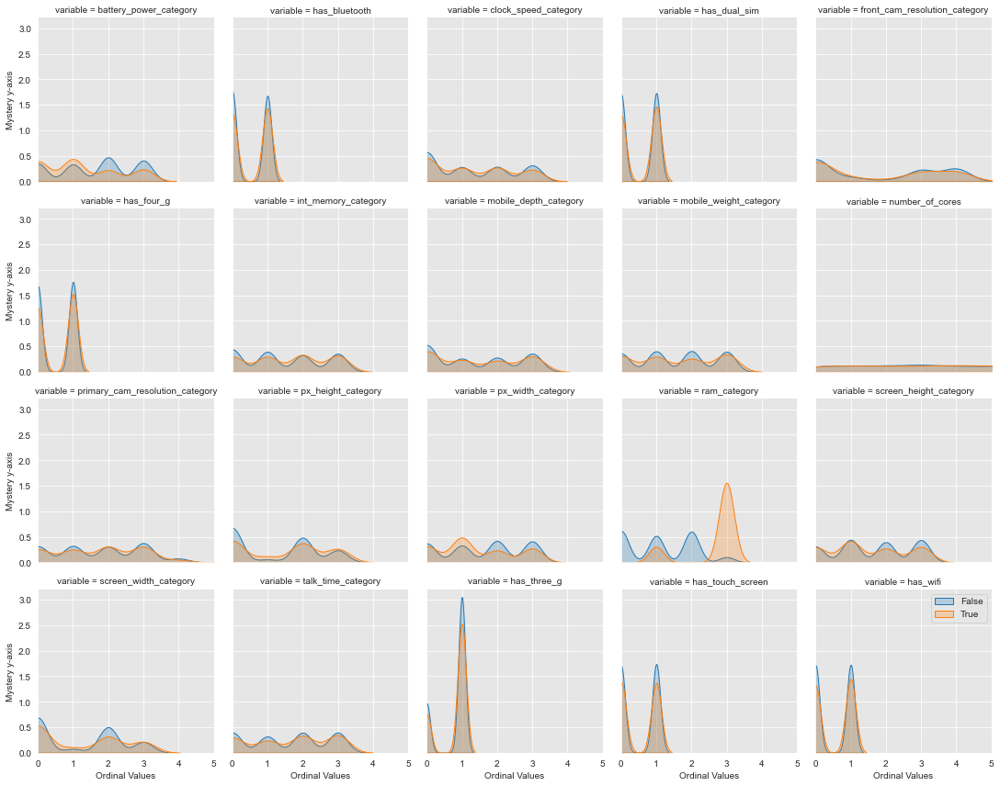

In [32]:
melted_data = pd.melt(discretised_ordered_data, "is_expensive", discretised_ordered_data.drop(["is_expensive"],axis="columns"), value_name="Ordinal Value",)
g = sns.FacetGrid(melted_data, col="variable", hue="is_expensive", col_wrap=5)
g.map(sns.kdeplot, "Ordinal Value", shade=True)
g.set_axis_labels("Ordinal Values", "Mystery y-axis")
plt.xlim(0,5)
plt.legend()
plt.show()

This shows the relative frequency graph of the discretised data, in ordinal form, split by the `is_expensive` field.  The variable `ram_category` displays a strong variance, regarding its seperation with the `is_expensive` field.

<br />

# <u>Association rule mining</u>


The idea of association rule mining (ARM) is to gather the characteristics that occurs frequently. Our approach is to take the characteristics of each of the phone atrributes (in the record) with the following strategy:

- keep the current cleaned data especially the boolean values;
- discretise the numeric values;

Before the "apriori" runs, the data should be in the form similar to:


|has_bluetooth|has_dual_sim|battery_power_0-100|...|
|---	|---	|---	|---	|
|True|False|True|True|
|True|True|False|True|
|False|True|True|False|

### ARM Pre-Processing

In [33]:
# restructuring cleaned_data for association rule mining
ARM_data = discretised_data

# Boolean Tables
ARM_structured_data = ARM_data.copy()[[item[0] for item in zip(ARM_data.columns,ARM_data.dtypes) if item[1] == np.bool]]

# Discretise data
non_boolean_values = ARM_data[[item[0] for item in zip(ARM_data.columns,ARM_data.dtypes) if item[1] != np.bool]]

# Adding extra columns from discretise data into columns
for non_boolean_column in non_boolean_values.columns:
    unique_values_in_column = ARM_data[non_boolean_column].unique()
    for category_name in unique_values_in_column:
        
        # Assign true if the current category name matches the data
        ARM_structured_data[f"{non_boolean_column}_{category_name}"] = ARM_data[non_boolean_column]==category_name
        
ARM_structured_data.head(3)

,has_bluetooth,has_dual_sim,has_four_g,has_three_g,has_touch_screen,has_wifi,is_expensive,"battery_power_category_(499.502, 875.25]","battery_power_category_(875.25, 1249.5]","battery_power_category_(1623.75, 1998.0]",...,"screen_height_category_(4.984999999999999, 8.5]","screen_height_category_(12.0, 15.5]","screen_width_category_(4.5, 9.0]","screen_width_category_(-0.019, 4.5]","screen_width_category_(9.0, 13.5]","screen_width_category_(13.5, 18.0]","talk_time_category_(15.5, 20.0]","talk_time_category_(6.5, 11.0]","talk_time_category_(11.0, 15.5]","talk_time_category_(1.981, 6.5]"
0,False,False,False,False,False,True,False,True,False,False,...,False,False,True,False,False,False,True,False,False,False
1,True,True,True,True,True,False,False,False,True,False,...,False,False,False,True,False,False,False,True,False,False
2,True,True,True,True,True,False,False,True,False,False,...,False,False,False,True,False,False,False,True,False,False


This is what the data looks like (above), after pre-processing for association rule mining.

In [34]:
ARM_structured_data.to_csv("./data/cleaned/ARM_item_characteristics.csv", index=False) # export to csv

### Frequent Pattern Mining: Apriori Algorithm

- Explination (apriori algo)


- Minimum support (expln) -> min amount for a rule to be considered a frequent (our case 10%). Probably not something that is good, but putting min support low, allows us to encompass ALL the rules (there are too many rules), whilst also allowing us to filter rules. If we set the support too high, then the program mines a stricter, limited amount of rules.


- Lift (expln)

- Confidence (expln)


- Belo

In [35]:
# This defines what is considered as a minimum item
MINIMUM_SUPPORT = 0.1
frequent_items = apriori(ARM_structured_data,min_support=MINIMUM_SUPPORT,use_colnames=True, verbose=True)
frequent_items

Processing 570 combinations | Sampling itemset size 5 4


,support,itemsets
0,0.4950,(has_bluetooth)
1,0.5095,(has_dual_sim)
2,0.5215,(has_four_g)
3,0.7615,(has_three_g)
4,0.5030,(has_touch_screen)
...,...,...
712,0.1165,"(screen_width_category_(-0.019, 4.5], has_wifi..."
713,0.1165,"(is_expensive, has_three_g, has_four_g, ram_ca..."
714,0.1000,"(screen_width_category_(-0.019, 4.5], clock_sp..."
715,0.1100,"(px_height_category_(-1.9609999999999999, 490...."


The (above) table demonstrates the item sets that meet the minimum defined support (`0.1`).

<br />

In [36]:
MINIMUM_CONFIDENCE_THRESHOLD = 0.20 # this is the minimum confidence threshold to mine
rules_by_confidence = association_rules(frequent_items, metric="confidence", min_threshold=MINIMUM_CONFIDENCE_THRESHOLD)

# Get all the rules that has mobile price
rules = rules_by_confidence[rules_by_confidence["consequents"].map(set(['is_expensive']).issubset)].sort_values("confidence",ascending=False)
rules.head(16)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
1554,"(has_four_g, ram_category_(3062.5, 3998.0])",(is_expensive),0.1360,0.2500,0.1165,0.856618,3.426471,0.082500,5.230769
2228,"(has_four_g, ram_category_(3062.5, 3998.0])","(is_expensive, has_three_g)",0.1360,0.1925,0.1165,0.856618,4.449962,0.090320,5.631795
2222,"(ram_category_(3062.5, 3998.0], has_four_g, ha...",(is_expensive),0.1360,0.2500,0.1165,0.856618,3.426471,0.082500,5.230769
1884,"(has_touch_screen, ram_category_(3062.5, 3998.0])",(is_expensive),0.1215,0.2500,0.1030,0.847737,3.390947,0.072625,4.925676
1758,"(ram_category_(3062.5, 3998.0], has_three_g)",(is_expensive),0.1935,0.2500,0.1635,0.844961,3.379845,0.115125,4.837500
1890,"(has_wifi, ram_category_(3062.5, 3998.0])",(is_expensive),0.1285,0.2500,0.1080,0.840467,3.361868,0.075875,4.701220
1022,"(has_bluetooth, ram_category_(3062.5, 3998.0])",(is_expensive),0.1300,0.2500,0.1090,0.838462,3.353846,0.076500,4.642857
573,"(ram_category_(3062.5, 3998.0])",(is_expensive),0.2510,0.2500,0.2090,0.832669,3.330677,0.146250,4.482143
1232,"(has_dual_sim, ram_category_(3062.5, 3998.0])",(is_expensive),0.1395,0.2500,0.1150,0.824373,3.297491,0.080125,4.270408
1761,"(ram_category_(3062.5, 3998.0])","(is_expensive, has_three_g)",0.2510,0.1925,0.1635,0.651394,3.383867,0.115183,2.316371


The above shows a min-confidence threshold of `0.65`, for the top 10 k-rules, and `0.43` for the top 16 k-rules.
- (change code to only show 10) and say the other 6 entries are omitted

### What are `K-rules`??

K rules are the rules that defines a certain frequently appearing item set, to define another attribute/group of attributes.


For example, according to the k=1 rule (sorted by `confidence`), if the phone has a `ram_category` that belongs in the range `3062.5 - 3998.0`, and ALSO has 4G (`has_four_g = True`), then there is a probability of 86% that this phone is expensive (`is_expensive = True`).

It should also be noted that the top 16 rules (`k=16`) all have an antecedent that contains `ram_category` in the aformentioned (`3062.5 - 3998.0`) range.

<br />

In [37]:
rules.iloc[17:21]

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction
571,"(front_cam_resolution_category_(0.981, 5.5])",(is_expensive),0.4380,0.2500,0.1160,0.264840,1.059361,0.006500,1.020186
1268,"(has_four_g, has_three_g)",(is_expensive),0.5215,0.2500,0.1375,0.263663,1.054650,0.007125,1.018555
1270,(has_four_g),"(is_expensive, has_three_g)",0.5215,0.1925,0.1375,0.263663,1.369675,0.037111,1.096644
202,(has_four_g),(is_expensive),0.5215,0.2500,0.1375,0.263663,1.054650,0.007125,1.018555


In [38]:
rules.to_csv("association_rule_mining/rules_by_confidence_minimum_threshold_0.20.csv")

For the 17th to the 20th rules, it can be seen that the minimum confidence threshold confidence is `0.26`:
    - has other attributes that can predict is_expensive

In [39]:
MINIMUM_LIFT_THRESHOLD = -5

rules_by_lift = association_rules(frequent_items, metric="lift", min_threshold=MINIMUM_LIFT_THRESHOLD)
rules_by_lift["translated_lift"] = rules_by_lift["lift"] - 1
rules_by_lift["is_translated_lift_negative"] = rules_by_lift["translated_lift"] < 0
rules_by_lift["absolute_value_of_translated_lift"] = np.abs(rules_by_lift["translated_lift"])


# Get all the rules that has mobile price
rules = rules_by_lift[rules_by_lift["consequents"].map(set(['is_expensive']).issubset)].sort_values("absolute_value_of_translated_lift",ascending=False)

In [40]:
rules.to_csv("association_rule_mining/rules_by_lift_sorted_by_absolute_value_of_translated_lift.csv")

In [41]:
rules.head(10)

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,translated_lift,is_translated_lift_negative,absolute_value_of_translated_lift
2407,"(has_four_g, ram_category_(3062.5, 3998.0])","(is_expensive, has_three_g)",0.1360,0.1925,0.1165,0.856618,4.449962,0.090320,5.631795,3.449962,False,3.449962
2406,"(ram_category_(3062.5, 3998.0], has_three_g)","(is_expensive, has_four_g)",0.1935,0.1375,0.1165,0.602067,4.378670,0.089894,2.167451,3.378670,False,3.378670
1277,"(ram_category_(3062.5, 3998.0])","(is_expensive, has_dual_sim)",0.2510,0.1325,0.1150,0.458167,3.457867,0.081742,1.601048,2.457867,False,2.457867
1646,"(has_four_g, ram_category_(3062.5, 3998.0])",(is_expensive),0.1360,0.2500,0.1165,0.856618,3.426471,0.082500,5.230769,2.426471,False,2.426471
2401,"(ram_category_(3062.5, 3998.0], has_four_g, ha...",(is_expensive),0.1360,0.2500,0.1165,0.856618,3.426471,0.082500,5.230769,2.426471,False,2.426471
2024,"(has_touch_screen, ram_category_(3062.5, 3998.0])",(is_expensive),0.1215,0.2500,0.1030,0.847737,3.390947,0.072625,4.925676,2.390947,False,2.390947
1883,"(ram_category_(3062.5, 3998.0])","(is_expensive, has_three_g)",0.2510,0.1925,0.1635,0.651394,3.383867,0.115183,2.316371,2.383867,False,2.383867
1880,"(ram_category_(3062.5, 3998.0], has_three_g)",(is_expensive),0.1935,0.2500,0.1635,0.844961,3.379845,0.115125,4.837500,2.379845,False,2.379845
1649,"(ram_category_(3062.5, 3998.0])","(is_expensive, has_four_g)",0.2510,0.1375,0.1165,0.464143,3.375589,0.081988,1.609572,2.375589,False,2.375589
2411,"(ram_category_(3062.5, 3998.0])","(is_expensive, has_four_g, has_three_g)",0.2510,0.1375,0.1165,0.464143,3.375589,0.081988,1.609572,2.375589,False,2.375589


- top 1 k-rule states that when a phone has ram category in the range `3062.5- 3998.0` and has four g, then there is a very strong positive correlation that 
- explain that the rules are sorted by the absolute_value_of_translated_lift in order to show sorted strength of correlation
- top 17 the rules here shows that ram category in the range `3062.5- 3998.0`


In [42]:
rules[18:21]

,antecedents,consequents,antecedent support,consequent support,support,confidence,lift,leverage,conviction,translated_lift,is_translated_lift_negative,absolute_value_of_translated_lift
2410,(has_four_g),"(is_expensive, ram_category_(3062.5, 3998.0], ...",0.5215,0.1635,0.1165,0.223394,1.366324,0.031235,1.077123,0.366324,False,0.366324
2409,(has_three_g),"(is_expensive, has_four_g, ram_category_(3062....",0.7615,0.1165,0.1165,0.152988,1.313198,0.027785,1.043078,0.313198,False,0.313198
1313,(has_three_g),"(is_expensive, has_four_g)",0.7615,0.1375,0.1375,0.180565,1.313198,0.032794,1.052554,0.313198,False,0.313198


- the 18th up to the 20th show different attribute with a lift that is positively correlated, but not as strong as the previous the rules.

## Recommendation
- According ARM
1. RAM category belong between `3062.5- 3998.0`
2. four G
3. touch scren
4. threeg
4. wifi
5. bluetooth

- ranked by the strongest defining confidence

# Classification

- brief explanation of classification
- talk a little bit about cross validation of folds of 10 (avoiding overfitting by using different parts of the data)
- talk a little bit about the RANDOM_STATE seeding (seed is defined to prevent uncontrolled changing of results)
- we will do it in Decision Tree and SVM
- the metric that will be used is accuracy (is_expensive and not expensive is equal in weighting)
- cleaned_data of continuous (not discrete). Methods such as SVM and Decision Trees are better at separating continuous attributes.

In [43]:
# Preprocessing of Cleaned Data
learning_data = cleaned_data.drop("id",axis="columns")
target_data = learning_data["is_expensive"]
feature_data = learning_data.drop("is_expensive",axis="columns")

## Decision Tree
- brief explanation what decision tree is decision on (gini index and information gain)

In [58]:
dt_pipeline_1 = Pipeline([
    ("dt_classifier",DecisionTreeClassifier(random_state=RANDOM_STATE))
])
# Grid Search
param_grid = {
    'dt_classifier__criterion': ["gini", "entropy"],
    'dt_classifier__max_depth': [None] + list(range(1,len(feature_data.columns)))
}

In [59]:
dt_pipeline_1_search = GridSearchCV(dt_pipeline_1, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
dt_pipeline_1_search.fit(feature_data,target_data)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('dt_classifier',
                                        DecisionTreeClassifier(random_state=1))]),
             n_jobs=-1,
             param_grid={'dt_classifier__criterion': ['gini', 'entropy'],
                         'dt_classifier__max_depth': [None, 1, 2, 3, 4, 5, 6, 7,
                                                      8, 9, 10, 11, 12, 13, 14,
                                                      15, 16, 17, 18, 19]})

In [64]:
pd.DataFrame(dt_pipeline_1_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_dt_classifier__criterion,param_dt_classifier__max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
26,0.016764,0.003578,0.003602,0.001024,entropy,6,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.96,0.950,0.955,0.960,0.940,0.925,0.965,0.945,0.940,0.935,0.9475,0.012093,1
28,0.015634,0.000505,0.002977,0.000451,entropy,8,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.95,0.945,0.940,0.960,0.925,0.950,0.955,0.945,0.945,0.920,0.9435,0.011843,2
29,0.016683,0.001641,0.003022,0.000069,entropy,9,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.95,0.950,0.945,0.955,0.920,0.935,0.945,0.945,0.950,0.920,0.9415,0.011843,3


In [61]:
print(f"Best Test Scores: {dt_pipeline_1_search.best_score_}")
print(f"Best Params: {dt_pipeline_1_search.best_params_}")

Best Test Scores: 0.9475
Best Params: {'dt_classifier__criterion': 'entropy', 'dt_classifier__max_depth': 6}


- talk about the best test score, the params (information gain) and compare the result with gini index

# Support Vector Machine

attribute reuction good with svm, not so great with the PCa -> Select k best...

In [45]:
svm_pipeline_2 = Pipeline([
    ("svm_classifier",SVC())
])

# Grid Search
param_grid = {
    'svm_classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid']
}

In [46]:
svm_pipeline_2_search = GridSearchCV(svm_pipeline_2, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
svm_pipeline_2_search.fit(feature_data,target_data)

GridSearchCV(cv=10, estimator=Pipeline(steps=[('svm_classifier', SVC())]),
             n_jobs=-1,
             param_grid={'svm_classifier__kernel': ['linear', 'poly', 'rbf',
                                                    'sigmoid']})

In [47]:
# Results in Tabular format
pd.DataFrame(svm_pipeline_2_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_svm_classifier__kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
0,6.028065,1.674049,0.002062,0.004632,linear,{'svm_classifier__kernel': 'linear'},0.990,0.985,0.975,0.990,0.995,0.985,0.99,1.000,0.990,0.995,0.9895,0.006500,1
1,0.018590,0.005162,0.002662,0.004650,poly,{'svm_classifier__kernel': 'poly'},0.985,0.975,0.960,0.995,0.980,0.995,0.99,0.980,0.980,0.985,0.9825,0.009811,2
2,0.029686,0.004684,0.008232,0.008318,rbf,{'svm_classifier__kernel': 'rbf'},0.980,0.975,0.970,0.985,0.975,0.985,0.99,0.975,0.965,0.985,0.9785,0.007433,3


In [56]:
print(f"Best Mean Test Scores of different Parameters: {svm_pipeline_2_search.best_score_}")
print(f"Best Params: {svm_pipeline_2_search.best_params_}")

Best Mean Test Scores of different Parameters: 0.9894999999999999
Best Params: {'svm_classifier__kernel': 'linear'}
Best CV Index: 0


- Talk about the top 3 best algorithm with their difference in parameters with emphasis on the best score 

## Comparison between DC and SVM
- Say that SVM is Chad between the two
- in terms of reasoning, it may be because SVM is robust to noise and outliers, hnece having a strong generalisation ability compared to a decision tree that fits better??

# Clustering
- explain a little bit about clustering


## Cluster of Size 2
- explain that we would expect that there are 2 groups and that is ideal for comparison with `is_expensive` field

### Kmeans
- short explanation of what kmeans

#### Confusion Table

In [66]:
kmeans_model = KMeans(n_clusters=2, random_state=RANDOM_STATE)
kmeans_model.fit(feature_data)
kmeans_prediction = kmeans_model.labels_

In [69]:
confusion_matrix = pd.DataFrame()
# target_data
confusion_matrix["target"] = target_data
confusion_matrix["prediction"] = kmeans_prediction
crosstab = pd.crosstab(confusion_matrix['target'], confusion_matrix['prediction'])
print(crosstab)

accuracy = np.diagonal(crosstab).sum() / crosstab.to_numpy().sum()
print(f"Accuracy: {accuracy}")

prediction    0    1
target              
False       977  523
True          0  500
Accuracy: 0.7385


- explain that the clustering has 73.85% accuracy wherein the other 26.15% inaccuracy is attributed to kmeans predicting a phone `is_expensive` when it is not (false positive), and 0% for false negative.

### Aglomerative Hierahical Clustering
- short explanation of what it is about

In [71]:
ac_pipeline = Pipeline([
    ("ac", AgglomerativeClustering(distance_threshold=0,n_clusters=None)) # Compute distances
])

In [74]:
ac_pipeline.fit(feature_data)

Pipeline(steps=[('ac',
                 AgglomerativeClustering(distance_threshold=0,
                                         n_clusters=None))])

#### Dendrogram

In [75]:
def plot_dendrogram(model, **kwargs):
    # Create linkage matrix and then plot the dendrogram

    # create the counts of samples under each node
    counts = np.zeros(model.children_.shape[0])
    n_samples = len(model.labels_)
    for i, merge in enumerate(model.children_):
        current_count = 0
        for child_idx in merge:
            if child_idx < n_samples:
                current_count += 1  # leaf node
            else:
                current_count += counts[child_idx - n_samples]
        counts[i] = current_count

    linkage_matrix = np.column_stack([model.children_, model.distances_,
                                      counts]).astype(float)

    # Plot the corresponding dendrogram
    dendrogram(linkage_matrix, **kwargs)
    return linkage_matrix

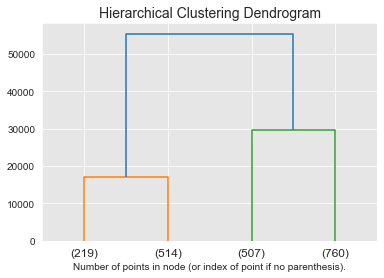

In [76]:
# plot the top three levels of the dendrogram
mat = plot_dendrogram(ac_pipeline[0], truncate_mode='level', p=1)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel("Number of points in node (or index of point if no parenthesis).")
plt.show()

- short explanation of the splitting of hierarchy into 4 parts, and also mentioning the size of 2 clusters (219+514) + (507+760)

#### Confusion Table

In [84]:
ac_model = AgglomerativeClustering(n_clusters=2)
ac_model.fit(feature_data)
ac_prediction = ac_model.labels_

confusion_matrix = pd.DataFrame()
# target_data
confusion_matrix["target"] = target_data
confusion_matrix["prediction"] =(ac_prediction+1)%2 # flip the predictions, clustering comparison to class always shifts to the bigger proportion
crosstab = pd.crosstab(confusion_matrix['target'], confusion_matrix['prediction'])
print(crosstab)

accuracy = np.diagonal(crosstab).sum() / crosstab.to_numpy().sum()
print(accuracy)

prediction    0    1
target              
False       733  767
True          0  500
0.6165


- explain hierarchical is not as great as kmeans. Although kmeans is sensitive to noise and outliers, agglometive is more sensitive as it can classify an outlier as its own hierachy or category.

### Validation of Two Cluster Size
- in the previous heading, it is assumed that cluster of size 2 is expected. This is an extra exploratory to validate whether a cluster of size 2 is the best way to split the data.

  4%|█████████▌                                                                                                                                                                                                                  | 1/23 [00:00<00:02,  8.41it/s]


[clusteval] >Fit using kmeans with metric: euclidean, and linkage: ward
[clusteval] >Evaluate using silhouette.


100%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 23/23 [00:06<00:00,  3.30it/s]


[clusteval] >Optimal number clusters detected: [2].
[clusteval] >Fin.


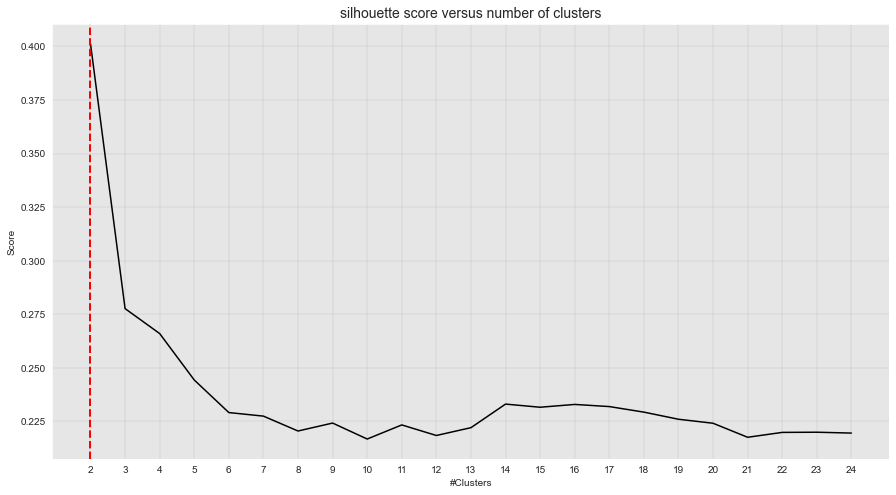

(<Figure size 1080x576 with 1 Axes>,
 <AxesSubplot:title={'center':'silhouette score versus number of clusters'}, xlabel='#Clusters', ylabel='Score'>)

In [70]:
cluster_evaluation = clusteval(method='silhouette',cluster="kmeans") 
cluster_evaluation.fit(np.array(feature_data))
cluster_evaluation.plot()

- explain silhouette score in the number of cluster
- say that 2 cluster is best according to silhouette score

# Data Reduction
- quick explanation data reduction and importance

## Numerosity Reduction
- quick explanation to remove rows refers to like outliers or incomplete data



In [264]:
from sklearn.ensemble import IsolationForest
from sklearn.svm import OneClassSVM
from sklearn.covariance import EllipticEnvelope
from sklearn.cluster import DBSCAN

# Attempt with PCA
PCA can summarise the multi-dimensional attributes into a lower dimensional plane such as 2D for visualisation. By Summarising it into 2D, it might be useful to help pinpoint possible outlier.

In [192]:
scaled = StandardScaler().fit_transform(feature_data)
model = PCA(n_components=2)
results = model.fit_transform(scaled)
PCA1_contribution, PCA2_contribution = model.explained_variance_ratio_*100

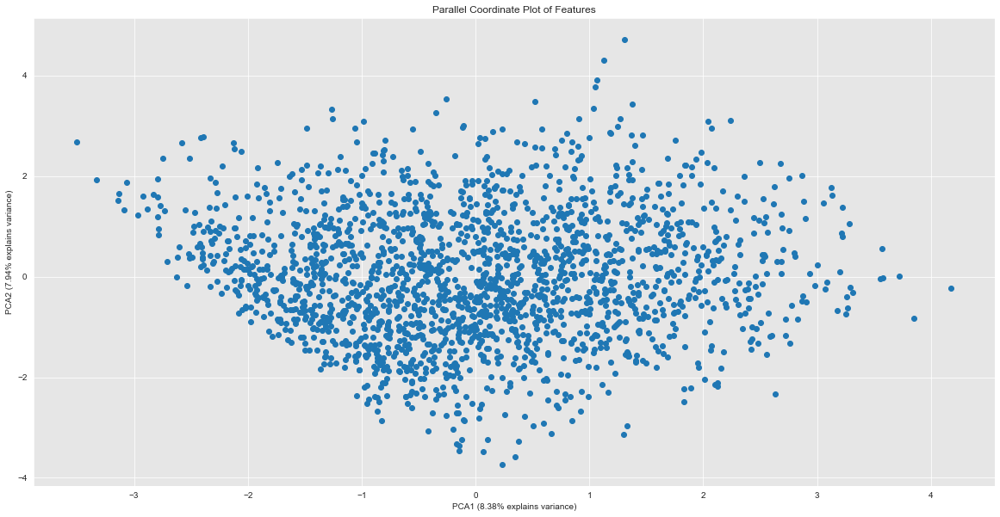

In [195]:
fig, ax = plt.subplots(figsize=(20,10))
plt.scatter(results[:,0],results[:,1])
plt.title("Parallel Coordinate Plot of Features")
plt.xlabel(f"PCA1 ({PCA1_contribution.round(2)}% explains variance)")
plt.ylabel(f"PCA2 ({PCA2_contribution.round(2)}% explains variance)")
plt.show()

As it can be seen, it is very hard to point out the outlier simply for 2 main reasons, the 2 principal components can only explain 16.48% of the variance, and that there is no obvious outlier that can be seen in the biplot shown above.

# Attempt with Parallel Coordinate Plot

In [155]:
from pandas.plotting import parallel_coordinates

[]

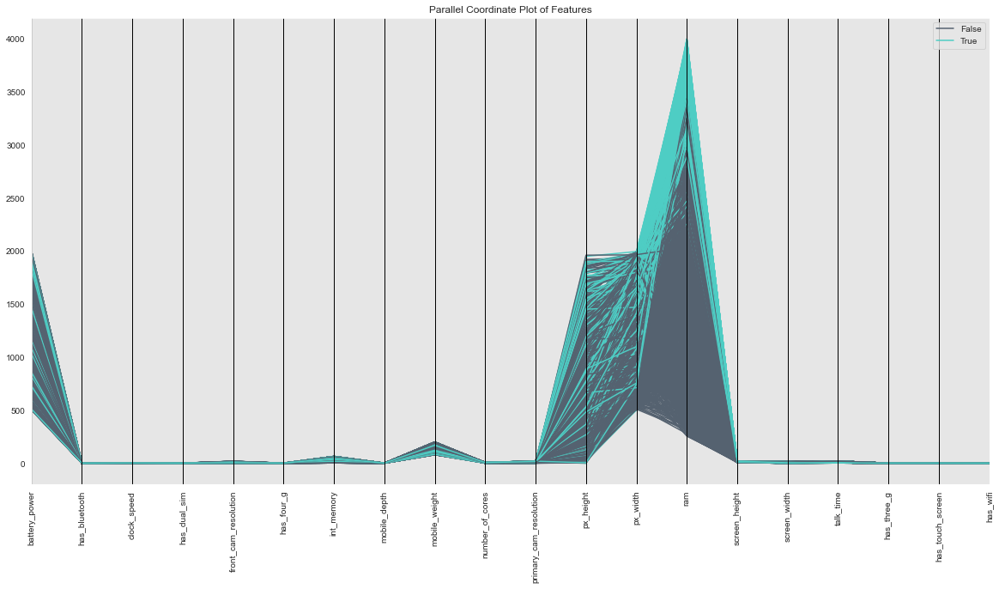

In [163]:
fig, ax = plt.subplots(figsize=(20,10))
pd.plotting.parallel_coordinates(
    learning_data, 'is_expensive', color=('#556270', '#4ECDC4')
)
plt.title("Parallel Coordinate Plot of Features")
plt.xticks(rotation=90)
plt.plot()

From the chart above, there is not that much that can be seen aside from RAM having the highest variation of between `true` and `false` of `is_expensive` field. Scaling is needed to better understand possible outlier, but chart above may support other analysis.

[]

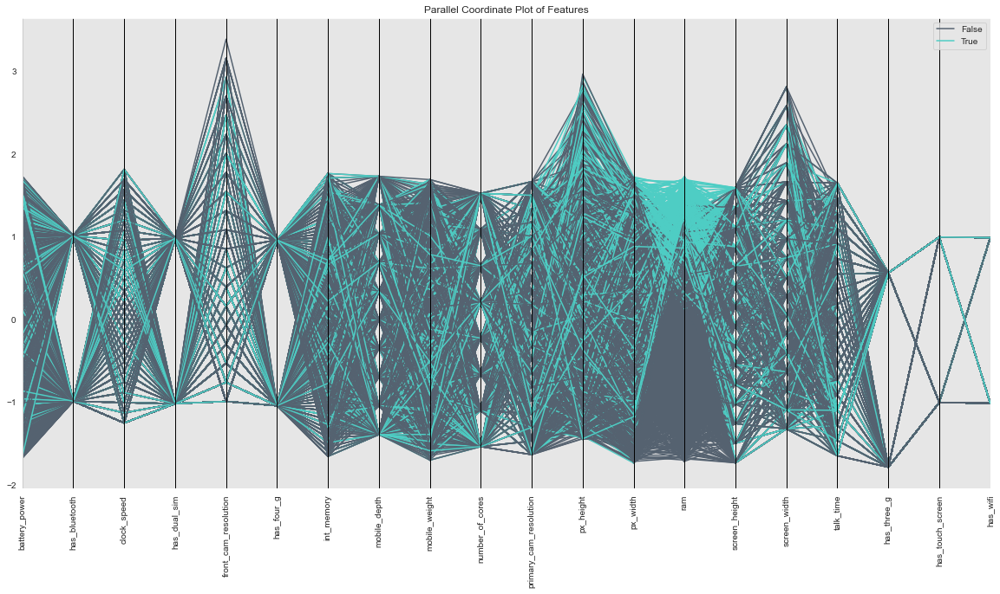

In [171]:
scaled_learning_data = pd.DataFrame(StandardScaler().fit_transform(learning_data),columns=learning_data.columns)
scaled_learning_data["is_expensive"] = learning_data["is_expensive"]
fig, ax = plt.subplots(figsize=(20,10))
pd.plotting.parallel_coordinates(
    scaled_learning_data, 'is_expensive', color=('#556270', '#4ECDC4')
)
plt.title("Parallel Coordinate Plot of Features")
plt.xticks(rotation=90)
plt.plot()

As it can be seen here, it is highly difficult to see if there are outliers that have a highly different pattern. This means that the attempt to use parallel coordinate plot to find possible outlier is a failure.

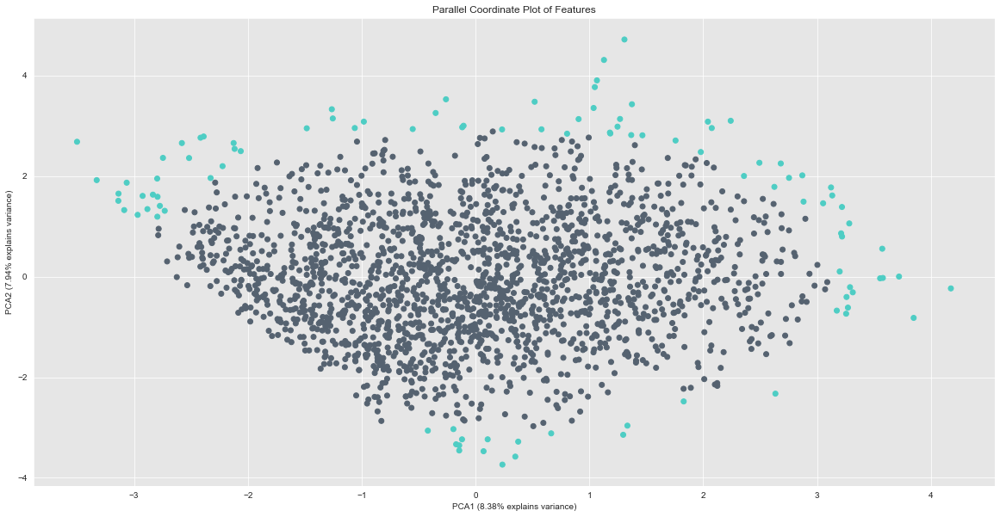

In [252]:
fig, ax = plt.subplots(figsize=(20,10))
pca_outliers = pd.DataFrame({"pca1":results[:,0],"pca2":results[:,1]})
outlier_identifier =  EllipticEnvelope(contamination=0.05)
pca_outliers["outlier_label"] = outlier_identifier.fit(pca_outliers).fit_predict(pca_outliers)
pca_outliers["colors"] =pca_outliers["outlier_label"].apply(lambda value : '#556270' if value > 0 else '#4ECDC4' )
plt.scatter(pca_outliers["pca1"],pca_outliers["pca2"],c=pca_outliers["colors"])
plt.title("Parallel Coordinate Plot of Features")
plt.xlabel(f"PCA1 ({PCA1_contribution.round(2)}% explains variance)")
plt.ylabel(f"PCA2 ({PCA2_contribution.round(2)}% explains variance)")

plt.show()

This is an isolation forest algorithm applied towards PCA. It can be seen that, it can somewhat pick points that are away from the rest. Hence, this will be used as a basis for removing out

In [253]:
feature_data_without_outliers_from_PCA = feature_data.copy().loc[pca_outliers["outlier_label"]>0,:]
target_data_without_outliers_from_PCA = target_data.copy().loc[pca_outliers["outlier_label"]>0]

## Decision Tree with Numerosity Reduction

In [254]:
dt_pipeline_3 = Pipeline([
    ("dt_classifier",DecisionTreeClassifier(random_state=RANDOM_STATE))
])
# Grid Search
param_grid = {
    'dt_classifier__criterion': ["gini", "entropy"],
    'dt_classifier__max_depth': [None] + list(range(1,len(feature_data.columns)))
}

In [255]:
dt_pipeline_3_search = GridSearchCV(dt_pipeline_3, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
dt_pipeline_3_search.fit(feature_data_without_outliers_from_PCA,target_data_without_outliers_from_PCA)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('dt_classifier',
                                        DecisionTreeClassifier(random_state=1))]),
             n_jobs=-1,
             param_grid={'dt_classifier__criterion': ['gini', 'entropy'],
                         'dt_classifier__max_depth': [None, 1, 2, 3, 4, 5, 6, 7,
                                                      8, 9, 10, 11, 12, 13, 14,
                                                      15, 16, 17, 18, 19]})

In [256]:
pd.DataFrame(dt_pipeline_3_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_dt_classifier__criterion,param_dt_classifier__max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
25,0.014596,0.001628,0.004003,0.003402,entropy,5,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.947368,0.963158,0.936842,0.978947,0.947368,0.936842,0.957895,0.947368,0.952632,0.931579,0.950000,0.013367,1
6,0.014108,0.000943,0.002898,0.000302,gini,6,"{'dt_classifier__criterion': 'gini', 'dt_class...",0.926316,0.947368,0.931579,0.973684,0.947368,0.968421,0.957895,0.931579,0.947368,0.963158,0.949474,0.015470,2
26,0.015202,0.001248,0.002901,0.000539,entropy,6,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.957895,0.952632,0.931579,0.963158,0.942105,0.963158,0.957895,0.921053,0.952632,0.931579,0.947368,0.014123,3


In [257]:
print(f"Best Test Scores: {dt_pipeline_3_search.best_score_}")
print(f"Best Params: {dt_pipeline_3_search.best_params_}")

Best Test Scores: 0.95
Best Params: {'dt_classifier__criterion': 'entropy', 'dt_classifier__max_depth': 5}


- Improved from 94.75% to 95%

## SVM with Numerosity Reduction

In [258]:
svm_pipeline_3 = Pipeline([
    ("scale", StandardScaler()),
    ("pca", PCA()),
    ("svm_classifier",SVC())
])

# Grid Search
param_grid = {
    'pca__n_components': range(1,len(feature_data.columns)),
    'svm_classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid', 'precomputed']
}

In [259]:
svm_pipeline_3_search = GridSearchCV(svm_pipeline_3, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
svm_pipeline_3_search.fit(feature_data_without_outliers_from_PCA,target_data_without_outliers_from_PCA)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('scale', StandardScaler()),
                                       ('pca', PCA()),
                                       ('svm_classifier', SVC())]),
             n_jobs=-1,
             param_grid={'pca__n_components': range(1, 20),
                         'svm_classifier__kernel': ['linear', 'poly', 'rbf',
                                                    'sigmoid', 'precomputed']})

In [260]:
pd.DataFrame(svm_pipeline_3_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_pca__n_components,param_svm_classifier__kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
85,0.046595,0.006358,0.004909,0.000536,18,linear,"{'pca__n_components': 18, 'svm_classifier__ker...",0.989474,0.984211,0.989474,0.984211,0.994737,0.984211,0.994737,1.000000,0.984211,0.984211,0.988947,0.005495,1
80,0.048393,0.007040,0.007502,0.005270,17,linear,"{'pca__n_components': 17, 'svm_classifier__ker...",0.984211,0.984211,0.989474,0.989474,0.989474,0.978947,0.994737,1.000000,0.989474,0.984211,0.988421,0.005669,2
90,0.046999,0.008788,0.005001,0.000897,19,linear,"{'pca__n_components': 19, 'svm_classifier__ker...",0.984211,0.989474,0.989474,0.984211,0.984211,0.978947,0.994737,0.989474,0.989474,0.984211,0.986842,0.004243,3


In [261]:
print(f"Best Test Scores: {svm_pipeline_3_search.best_score_}")
print(f"Best Params: {svm_pipeline_3_search.best_params_}")
print(f"Best CV Index: {svm_pipeline_3_search.best_index_}")

Best Test Scores: 0.9889473684210527
Best Params: {'pca__n_components': 18, 'svm_classifier__kernel': 'linear'}
Best CV Index: 85


- Worsened from 98.95% to 98.89%

# PCA with DBScan Outlier Numerosity Reduction

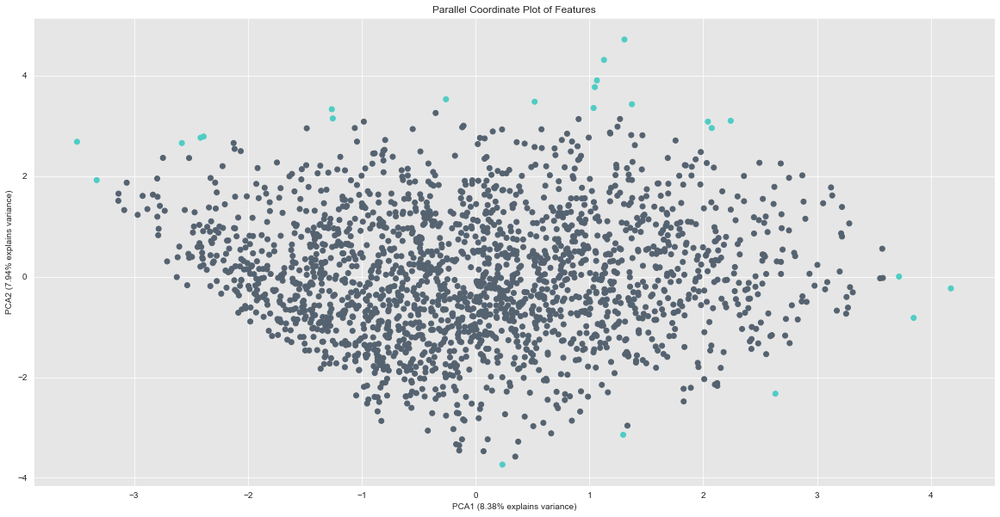

In [378]:
fig, ax = plt.subplots(figsize=(20,10))
pca_outliers = pd.DataFrame({"pca1":results[:,0],"pca2":results[:,1]})
model = DBSCAN(eps=1,min_samples=100).fit(pca_outliers)
pca_outliers["outlier_label"] = model.labels_

pca_outliers["colors"] =pca_outliers["outlier_label"].apply(lambda value : '#556270' if value >= 0 else '#4ECDC4' )
plt.scatter(pca_outliers["pca1"],pca_outliers["pca2"],c=pca_outliers["colors"])
plt.title("Parallel Coordinate Plot of Features")
plt.xlabel(f"PCA1 ({PCA1_contribution.round(2)}% explains variance)")
plt.ylabel(f"PCA2 ({PCA2_contribution.round(2)}% explains variance)")
plt.show()

In [379]:
feature_data_without_outliers_from_PCA = feature_data.copy().loc[pca_outliers["outlier_label"]>=0,:]
target_data_without_outliers_from_PCA = target_data.copy().loc[pca_outliers["outlier_label"]>=0]

As it can be seen here, this is what DBSCAN looks like on PCA Biplots to identify outliers.

## Decision Tree with Numerosity Reduction

In [380]:
dt_pipeline_3 = Pipeline([
    ("dt_classifier",DecisionTreeClassifier(random_state=RANDOM_STATE))
])
# Grid Search
param_grid = {
    'dt_classifier__criterion': ["gini", "entropy"],
    'dt_classifier__max_depth': [None] + list(range(1,len(feature_data.columns)))
}

In [381]:
dt_pipeline_3_search = GridSearchCV(dt_pipeline_3, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
dt_pipeline_3_search.fit(feature_data_without_outliers_from_PCA,target_data_without_outliers_from_PCA)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('dt_classifier',
                                        DecisionTreeClassifier(random_state=1))]),
             n_jobs=-1,
             param_grid={'dt_classifier__criterion': ['gini', 'entropy'],
                         'dt_classifier__max_depth': [None, 1, 2, 3, 4, 5, 6, 7,
                                                      8, 9, 10, 11, 12, 13, 14,
                                                      15, 16, 17, 18, 19]})

In [382]:
pd.DataFrame(dt_pipeline_3_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_dt_classifier__criterion,param_dt_classifier__max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
26,0.018704,0.006001,0.003199,0.000396,entropy,6,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.959596,0.959596,0.959596,0.949495,0.939394,0.954545,0.964467,0.934010,0.928934,0.944162,0.949380,0.011613,1
20,0.016302,0.001786,0.004101,0.003987,entropy,None,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.949495,0.964646,0.944444,0.944444,0.929293,0.964646,0.959391,0.939086,0.949239,0.944162,0.948885,0.010721,2
38,0.015597,0.001356,0.003005,0.000453,entropy,18,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.949495,0.964646,0.944444,0.944444,0.929293,0.964646,0.959391,0.939086,0.949239,0.944162,0.948885,0.010721,2


In [383]:
print(f"Best Test Scores: {dt_pipeline_3_search.best_score_}")
print(f"Best Params: {dt_pipeline_3_search.best_params_}")

Best Test Scores: 0.9493795826283137
Best Params: {'dt_classifier__criterion': 'entropy', 'dt_classifier__max_depth': 6}


- improved from 94.75% to 94.94%

## SVM with Numerosity Reduction

In [384]:
svm_pipeline_3 = Pipeline([
    ("scale", StandardScaler()),
    ("pca", PCA()),
    ("svm_classifier",SVC())
])

# Grid Search
param_grid = {
    'pca__n_components': range(1,len(feature_data.columns)),
    'svm_classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid', 'precomputed']
}

In [385]:
svm_pipeline_3_search = GridSearchCV(svm_pipeline_3, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
svm_pipeline_3_search.fit(feature_data_without_outliers_from_PCA,target_data_without_outliers_from_PCA)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('scale', StandardScaler()),
                                       ('pca', PCA()),
                                       ('svm_classifier', SVC())]),
             n_jobs=-1,
             param_grid={'pca__n_components': range(1, 20),
                         'svm_classifier__kernel': ['linear', 'poly', 'rbf',
                                                    'sigmoid', 'precomputed']})

In [386]:
pd.DataFrame(svm_pipeline_3_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_pca__n_components,param_svm_classifier__kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
85,0.049485,0.008124,0.006002,0.002485,18,linear,"{'pca__n_components': 18, 'svm_classifier__ker...",0.989899,0.984848,0.979798,0.989899,0.994949,0.994949,0.994924,1.000000,0.984772,0.984772,0.989881,0.005987,1
80,0.042518,0.005325,0.005564,0.003678,17,linear,"{'pca__n_components': 17, 'svm_classifier__ker...",0.989899,0.984848,0.979798,0.984848,0.989899,0.994949,0.994924,1.000000,0.984772,0.984772,0.988871,0.005898,2
90,0.052201,0.007006,0.005400,0.001112,19,linear,"{'pca__n_components': 19, 'svm_classifier__ker...",0.984848,0.989899,0.994949,0.989899,0.989899,0.984848,0.984772,0.984772,0.994924,0.984772,0.988358,0.003961,3


In [387]:
print(f"Best Test Scores: {svm_pipeline_3_search.best_score_}")
print(f"Best Params: {svm_pipeline_3_search.best_params_}")
print(f"Best CV Index: {svm_pipeline_3_search.best_index_}")

Best Test Scores: 0.9898810439419575
Best Params: {'pca__n_components': 18, 'svm_classifier__kernel': 'linear'}
Best CV Index: 85


- It improved from 98.95% to 98.99% (a little change)

### Principal Component Analysis (PCA)
- quick explanation of PCA
- need scaling before doing PCA

#### Decision Tree with PCA

In [91]:
dt_pipeline_3 = Pipeline([
    ("scale", StandardScaler()),
    ("pca", PCA()),
    ("dt_classifier",DecisionTreeClassifier(random_state=RANDOM_STATE))
])
# Grid Search
param_grid = {
    'pca__n_components': range(1,len(feature_data.columns)),
    'dt_classifier__criterion': ["gini", "entropy"],
    'dt_classifier__max_depth': [None] + list(range(1,len(feature_data.columns)))
}

In [92]:
dt_pipeline_3_search = GridSearchCV(dt_pipeline_3, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
dt_pipeline_3_search.fit(feature_data,target_data)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('scale', StandardScaler()),
                                       ('pca', PCA()),
                                       ('dt_classifier',
                                        DecisionTreeClassifier(random_state=1))]),
             n_jobs=-1,
             param_grid={'dt_classifier__criterion': ['gini', 'entropy'],
                         'dt_classifier__max_depth': [None, 1, 2, 3, 4, 5, 6, 7,
                                                      8, 9, 10, 11, 12, 13, 14,
                                                      15, 16, 17, 18, 19],
                         'pca__n_components': range(1, 20)})

In [93]:
pd.DataFrame(dt_pipeline_3_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_dt_classifier__criterion,param_dt_classifier__max_depth,param_pca__n_components,params,split0_test_score,split1_test_score,...,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
568,0.087823,0.028747,0.004779,0.001880,entropy,9,18,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.86,0.810,...,0.80,0.85,0.855,0.835,0.885,0.785,0.860,0.8395,0.029871,1
682,0.071594,0.011491,0.004700,0.001340,entropy,15,18,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.84,0.825,...,0.80,0.85,0.855,0.810,0.880,0.810,0.855,0.8385,0.024804,2
566,0.069499,0.012947,0.005803,0.003314,entropy,9,16,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.84,0.830,...,0.81,0.86,0.835,0.830,0.885,0.790,0.855,0.8385,0.025204,3


In [95]:
print(f"Best Test Scores: {dt_pipeline_3_search.best_score_}")
print(f"Best Params: {dt_pipeline_3_search.best_params_}")

Best Test Scores: 0.8394999999999999
Best Params: {'dt_classifier__criterion': 'entropy', 'dt_classifier__max_depth': 9, 'pca__n_components': 18}


- explain PCA worsened Decision Tree Classifier from 94.75% amount to 84% accuracy

#### SVM with PCA

In [96]:
svm_pipeline_3 = Pipeline([
    ("scale", StandardScaler()),
    ("pca", PCA()),
    ("svm_classifier",SVC())
])

# Grid Search
param_grid = {
    'pca__n_components': range(1,len(feature_data.columns)),
    'svm_classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid', 'precomputed']
}

In [97]:
svm_pipeline_3_search = GridSearchCV(svm_pipeline_3, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
svm_pipeline_3_search.fit(feature_data,target_data)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('scale', StandardScaler()),
                                       ('pca', PCA()),
                                       ('svm_classifier', SVC())]),
             n_jobs=-1,
             param_grid={'pca__n_components': range(1, 20),
                         'svm_classifier__kernel': ['linear', 'poly', 'rbf',
                                                    'sigmoid', 'precomputed']})

In [98]:
pd.DataFrame(svm_pipeline_3_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_pca__n_components,param_svm_classifier__kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
85,0.060561,0.008707,0.006495,0.002010,18,linear,"{'pca__n_components': 18, 'svm_classifier__ker...",0.99,0.985,0.990,0.985,1.000,0.990,0.995,1.000,0.99,0.985,0.9910,0.005385,1
80,0.059988,0.010184,0.006164,0.001340,17,linear,"{'pca__n_components': 17, 'svm_classifier__ker...",0.99,0.985,0.990,0.985,0.995,0.995,0.995,1.000,0.99,0.985,0.9910,0.004899,1
90,0.065998,0.020581,0.007602,0.002373,19,linear,"{'pca__n_components': 19, 'svm_classifier__ker...",0.99,0.990,0.995,0.985,0.990,0.985,0.990,0.985,1.00,0.985,0.9895,0.004717,3


In [99]:
print(f"Best Test Scores: {svm_pipeline_3_search.best_score_}")
print(f"Best Params: {svm_pipeline_3_search.best_params_}")
print(f"Best CV Index: {svm_pipeline_3_search.best_index_}")

Best Test Scores: 0.991
Best Params: {'pca__n_components': 17, 'svm_classifier__kernel': 'linear'}
Best CV Index: 80


- PCA improved SVM from 98.95 to 99.1%

### Select K-Best with Information Gain (Entropy) and ANOVA F-statistic
- quick explanation information gain (used in decision trees) and ANOVA looking at variance for forward and backward selection

#### Decision Tree with Select K-Best

In [106]:
dt_pipeline_4 = Pipeline([
    ("select_kbest", SelectKBest()),
    ("dt_classifier",DecisionTreeClassifier(random_state=RANDOM_STATE))
])
# Grid Search - REDUCED BECAUSE IT IS TAKING A LONG TIME
param_grid = {
    'select_kbest__k': range(10,18),
    'select_kbest__score_func': [f_classif,mutual_info_classif], # F-value statistic and Information Gain (entropy)
    'dt_classifier__criterion': ["entropy"], # - Entropy is better than GINI from previous results
    'dt_classifier__max_depth': [None] + list(range(1,len(feature_data.columns)))
}

In [107]:
dt_pipeline_4_search = GridSearchCV(dt_pipeline_4, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
dt_pipeline_4_search.fit(feature_data,target_data)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('select_kbest', SelectKBest()),
                                       ('dt_classifier',
                                        DecisionTreeClassifier(random_state=1))]),
             n_jobs=-1,
             param_grid={'dt_classifier__criterion': ['entropy'],
                         'dt_classifier__max_depth': [None, 1, 2, 3, 4, 5, 6, 7,
                                                      8, 9, 10, 11, 12, 13, 14,
                                                      15, 16, 17, 18, 19],
                         'select_kbest__k': range(1, 20),
                         'select_kbest__score_func': [<function f_classif at 0x000001B3AE706EE0>,
                                                      <function mutual_info_classif at 0x000001B3AE71DCA0>]})

In [108]:
pd.DataFrame(dt_pipeline_4_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_dt_classifier__criterion,param_dt_classifier__max_depth,param_select_kbest__k,param_select_kbest__score_func,params,split0_test_score,...,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
332,0.028280,0.007457,0.003514,0.000646,entropy,8,15,<function f_classif at 0x000001B3AE706EE0>,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.97,...,0.955,0.925,0.955,0.965,0.950,0.955,0.935,0.9515,0.012855,1
260,0.023998,0.000776,0.004201,0.001401,entropy,6,17,<function f_classif at 0x000001B3AE706EE0>,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.96,...,0.960,0.940,0.950,0.970,0.945,0.940,0.955,0.9515,0.009233,2
256,0.025497,0.002201,0.004097,0.000300,entropy,6,15,<function f_classif at 0x000001B3AE706EE0>,"{'dt_classifier__criterion': 'entropy', 'dt_cl...",0.96,...,0.960,0.940,0.950,0.965,0.945,0.940,0.955,0.9515,0.008382,2


In [109]:
print(f"Best Test Scores: {dt_pipeline_4_search.best_score_}")
print(f"Best Params: {dt_pipeline_4_search.best_params_}")
print(f"Best CV Index: {dt_pipeline_4_search.best_index_}")

Best Test Scores: 0.9515
Best Params: {'dt_classifier__criterion': 'entropy', 'dt_classifier__max_depth': 8, 'select_kbest__k': 15, 'select_kbest__score_func': <function f_classif at 0x000001B3AE706EE0>}
Best CV Index: 332


Number of Attributes: 15


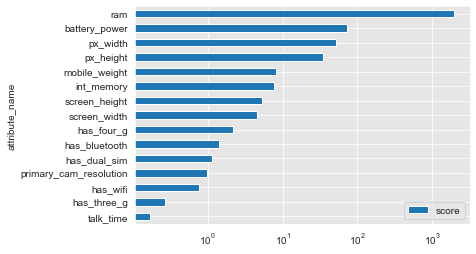

In [131]:
select_k_best = dt_pipeline_4_search.best_estimator_[0]
attributes_df = pd.DataFrame({"attribute_name": feature_data.columns[select_k_best.get_support()],"score": select_k_best.scores_[select_k_best.get_support()]})
attributes_df.sort_values("score").plot(x="attribute_name",y="score",kind="barh", logx=True)
print(f"Number of Attributes: {len(attributes_df)}")

- explanation on the attributes (some comparison from the earlier exploratory data analaysis), explain there are 15 attributes
- improvement from 94.75% to 95.15% accuracy
- explain that in this scenario F-statistic is better than information gain in the transformation, but information gain is later used for the decision tree classifier

#### SVM with Select K-Best

In [55]:
svm_pipeline_4 = Pipeline([  
    ("select_kbest", SelectKBest()),
    ("svm_classifier",SVC())
])

# Grid Search # REDUCED - because it is taking a long time
param_grid = {
    'select_kbest__k': range(10,18),
    'select_kbest__score_func': [f_classif,mutual_info_classif], # F-value statistic and Information Gain (entropy)
    'svm_classifier__kernel': ['linear', 'rbf'] # removed other attributes that seems to be inaccurate
}

In [56]:
svm_pipeline_4_search = GridSearchCV(svm_pipeline_4, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
svm_pipeline_4_search.fit(feature_data,target_data)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('select_kbest', SelectKBest()),
                                       ('svm_classifier', SVC())]),
             n_jobs=-1,
             param_grid={'select_kbest__k': range(10, 18),
                         'select_kbest__score_func': [<function f_classif at 0x000001D08EE74D30>,
                                                      <function mutual_info_classif at 0x000001D08EE8DAF0>],
                         'svm_classifier__kernel': ['linear', 'rbf']})

In [68]:
print(f"Best Test Scores: {svm_pipeline_4_search.best_score_}")
print(f"Best Params: {svm_pipeline_4_search.best_params_}")
print(f"Best CV Index: {svm_pipeline_4_search.best_index_}")

Best Test Scores: 0.9914999999999999
Best Params: {'select_kbest__k': 10, 'select_kbest__score_func': <function f_classif at 0x000001D08EE74D30>, 'svm_classifier__kernel': 'linear'}
Best CV Index: 0


Number of Attributes: 10


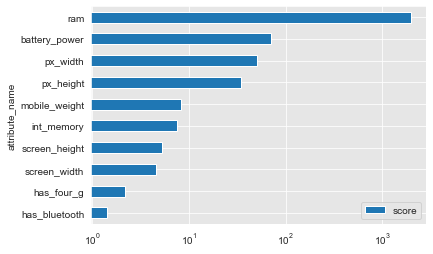

In [69]:
select_k_best = svm_pipeline_4_search.best_estimator_[0]
attributes_df = pd.DataFrame({"attribute_name": feature_data.columns[select_k_best.get_support()],"score": select_k_best.scores_[select_k_best.get_support()]})
attributes_df.sort_values("score").plot(x="attribute_name",y="score",kind="barh", logx=True)
print(f"Number of Attributes: {len(attributes_df)}")

- improvement 98.95% to 99.2% (0.1% better than PCA)
- compare the previous attribute selection if it is the same

# Attribute Selection
- do manual selection of attribute
- compare to previous 
- also refer to the decision tree

In [140]:
MANUALLY_SELECTED_ATTRIBUTES = [
    "ram",
    "has_four_g",
    "mobile_depth",
    "screen_width",
    "screen_height",
    "primary_cam_resolution",
    "number_of_cores",
    "int_memory",
    "px_width",
    "px_height",
] # based on domain-specific knowledge and the exploratory plots
feature_data_manually_selected = learning_data.drop("is_expensive",axis="columns")[MANUALLY_SELECTED_ATTRIBUTES]

## Decision Tree with Manually Selected Attribute

In [152]:
dt_pipeline_1 = Pipeline([
    ("dt_classifier",DecisionTreeClassifier(random_state=RANDOM_STATE))
])
# Grid Search
param_grid = {
    'dt_classifier__criterion': ["gini", "entropy"],
    'dt_classifier__max_depth': [None] + list(range(1,len(feature_data.columns)))
}

In [153]:
dt_pipeline_1_search = GridSearchCV(dt_pipeline_1, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
dt_pipeline_1_search.fit(feature_data_manually_selected,target_data)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('dt_classifier',
                                        DecisionTreeClassifier(random_state=1))]),
             n_jobs=-1,
             param_grid={'dt_classifier__criterion': ['gini', 'entropy'],
                         'dt_classifier__max_depth': [None, 1, 2, 3, 4, 5, 6, 7,
                                                      8, 9, 10, 11, 12, 13, 14,
                                                      15, 16, 17, 18, 19]})

In [154]:
pd.DataFrame(dt_pipeline_1_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_dt_classifier__criterion,param_dt_classifier__max_depth,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
4,0.009575,0.001218,0.003298,0.000785,gini,4,"{'dt_classifier__criterion': 'gini', 'dt_class...",0.945,0.930,0.91,0.930,0.905,0.930,0.925,0.915,0.92,0.925,0.9235,0.010966,1
2,0.006183,0.000531,0.002245,0.000647,gini,2,"{'dt_classifier__criterion': 'gini', 'dt_class...",0.940,0.925,0.90,0.925,0.900,0.905,0.935,0.925,0.91,0.950,0.9215,0.016439,2
1,0.005083,0.000823,0.002118,0.000592,gini,1,"{'dt_classifier__criterion': 'gini', 'dt_class...",0.940,0.925,0.90,0.925,0.900,0.905,0.935,0.925,0.91,0.950,0.9215,0.016439,2


In [155]:
print(f"Best Test Scores: {dt_pipeline_1_search.best_score_}")
print(f"Best Params: {dt_pipeline_1_search.best_params_}")

Best Test Scores: 0.9235000000000001
Best Params: {'dt_classifier__criterion': 'gini', 'dt_classifier__max_depth': 4}


- discuss manually selected attribute lowered from 94.75% to 92.35%

## SVM with Manually Selected Attributes

In [156]:
svm_pipeline_2 = Pipeline([
    ("svm_classifier",SVC())
])

# Grid Search
param_grid = {
    'svm_classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid']
}

In [157]:
svm_pipeline_2_search = GridSearchCV(svm_pipeline_2, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
svm_pipeline_2_search.fit(feature_data_manually_selected,target_data)

GridSearchCV(cv=10, estimator=Pipeline(steps=[('svm_classifier', SVC())]),
             n_jobs=-1,
             param_grid={'svm_classifier__kernel': ['linear', 'poly', 'rbf',
                                                    'sigmoid']})

In [158]:
pd.DataFrame(svm_pipeline_2_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_svm_classifier__kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
2,0.032715,0.005635,0.007385,0.003936,rbf,{'svm_classifier__kernel': 'rbf'},0.955,0.925,0.910,0.93,0.915,0.925,0.935,0.925,0.925,0.95,0.9295,0.013314,1
0,9.289903,1.945174,0.002222,0.000594,linear,{'svm_classifier__kernel': 'linear'},0.960,0.930,0.915,0.94,0.885,0.920,0.920,0.920,0.925,0.95,0.9265,0.019628,2
1,0.024853,0.002617,0.004201,0.000980,poly,{'svm_classifier__kernel': 'poly'},0.955,0.915,0.910,0.93,0.905,0.925,0.930,0.920,0.925,0.95,0.9265,0.015174,2


In [159]:
print(f"Best Test Scores: {svm_pipeline_2_search.best_score_}")
print(f"Best Params: {svm_pipeline_2_search.best_params_}")

Best Test Scores: 0.9295
Best Params: {'svm_classifier__kernel': 'rbf'}


- discuss lowered accuracy from 98.95% to 92.95%

In [388]:
# Putting it all together
# SVM with Select K-best on DBScan Data

In [395]:
svm_pipeline_3 = Pipeline([
    ("select_kbest", SelectKBest()),
    ("svm_classifier",SVC())
])

# Grid Search
param_grid = {
    'select_kbest__k': range(10,18),
    'svm_classifier__kernel': ['linear', 'poly', 'rbf']
}

In [396]:
svm_pipeline_3_search = GridSearchCV(svm_pipeline_3, param_grid, n_jobs=-1, cv=CROSS_VALIDATION_PARTITION)
svm_pipeline_3_search.fit(feature_data_without_outliers_from_PCA,target_data_without_outliers_from_PCA)

GridSearchCV(cv=10,
             estimator=Pipeline(steps=[('select_kbest', SelectKBest()),
                                       ('svm_classifier', SVC())]),
             n_jobs=-1,
             param_grid={'select_kbest__k': range(10, 18),
                         'svm_classifier__kernel': ['linear', 'poly', 'rbf']})

In [397]:
pd.DataFrame(svm_pipeline_3_search.cv_results_).sort_values(by="mean_test_score",ascending=False).head(3)

,mean_fit_time,std_fit_time,mean_score_time,std_score_time,param_select_kbest__k,param_svm_classifier__kernel,params,split0_test_score,split1_test_score,split2_test_score,split3_test_score,split4_test_score,split5_test_score,split6_test_score,split7_test_score,split8_test_score,split9_test_score,mean_test_score,std_test_score,rank_test_score
6,10.145810,5.801542,0.002000,0.001342,12,linear,"{'select_kbest__k': 12, 'svm_classifier__kerne...",0.989899,0.984848,0.994949,0.989899,0.989899,0.979798,0.994924,1.0,0.994924,0.994924,0.991406,0.005551,1
3,10.561067,5.420574,0.002614,0.001096,11,linear,"{'select_kbest__k': 11, 'svm_classifier__kerne...",0.989899,0.984848,0.994949,0.989899,0.989899,0.979798,0.994924,1.0,0.994924,0.994924,0.991406,0.005551,1
0,16.645999,24.494537,0.003063,0.004419,10,linear,"{'select_kbest__k': 10, 'svm_classifier__kerne...",0.989899,0.984848,0.994949,0.989899,0.994949,0.979798,0.994924,1.0,0.989848,0.994924,0.991404,0.005554,3


In [398]:
print(f"Best Test Scores: {svm_pipeline_3_search.best_score_}")
print(f"Best Params: {svm_pipeline_3_search.best_params_}")
print(f"Best CV Index: {svm_pipeline_3_search.best_index_}")

Best Test Scores: 0.991406450289699
Best Params: {'select_kbest__k': 11, 'svm_classifier__kernel': 'linear'}
Best CV Index: 3


# <u>Appendix</u>

#### Raw Data Profiling Report

In [49]:
raw_profile = ProfileReport(raw_data, explorative=True, orange_mode=True, title="Raw Data Profiling Report")

# set the Metadata
metadata_dict = raw_metadata.to_dict()["Explaination"]
raw_profile.set_variable("variables.descriptions",metadata_dict)
raw_profile.to_file("./profile_reports/raw_data_profile.html")

raw_profile

#### Clean Data Profiling Report

In [50]:
# Generate new pandas-profiling 
cleaned_data_profile = ProfileReport(cleaned_data, explorative=True, orange_mode=True, title="Clean Data Profiling Report")
cleaned_data_profile.set_variable("variables.descriptions",cleaned_metadata_dict) # Set Metadata                  
cleaned_data_profile.to_file("./profile_reports/cleaned_data_profile.html")
cleaned_data_profile

C:\Users\frinz\anaconda3\lib\site-packages\pandas\core\frame.py:4296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(


#### Discretised Data Profiling Report

In [51]:
# Generate new pandas-profiling 
discretised_data_profile = ProfileReport(discretised_data, explorative=True, orange_mode=True, title="Discretised Data Profiling Report")
discretised_data_profile.set_variable("variables.descriptions",cleaned_metadata_dict) # Set Metadata                  
discretised_data_profile.to_file("./profile_reports/discretised_data_profile.html")
discretised_data_profile

C:\Users\frinz\anaconda3\lib\site-packages\pandas\core\frame.py:4296: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  return super().rename(
